
| Variable Name | Role    | Type        | Demographic    | Description                                                                                                           | Units | Missing Values |
|---------------|---------|-------------|----------------|-----------------------------------------------------------------------------------------------------------------------|-------|----------------|
| age           | Feature | Integer     | Age            |                                                                                                                       |       | no             |
| job           | Feature | Categorical | Occupation     | type of job (categorical: 'admin.','blue-collar','entrepreneur','housemaid','management','retired','self-employed'...) |       | no             |
| marital       | Feature | Categorical | Marital Status | marital status (categorical: 'divorced','married','single','unknown'; note: 'divorced' means divorced or widowed)      |       | no             |
| education     | Feature | Categorical | Education Level| (categorical: 'basic.4y','basic.6y','basic.9y','high.school','illiterate','professional.course','university.degree'...)|       | no             |
| default       | Feature | Binary      |                | has credit in default?                                                                                                |       | no             |
| balance       | Feature | Integer     |                | average yearly balance                                                                                                | euros | no             |
| housing       | Feature | Binary      |                | has housing loan?                                                                                                     |       | no             |
| loan          | Feature | Binary      |                | has personal loan?                                                                                                    |       | no             |
| contact       | Feature | Categorical |                | contact communication type (categorical: 'cellular','telephone')                                                      |       | yes            |
| day_of_week   | Feature | Date        |                | last contact day of the week                                                                                          |       | no             |
| month         | Feature | Date        |                | last contact month of year (categorical: 'jan', 'feb', 'mar', ..., 'nov', 'dec')                                      |       | no             |
| duration      | Feature | Integer     |                | last contact duration, in seconds (numeric). Important note: this attribute highly affects the output target...        |       | no             |
| campaign      | Feature | Integer     |                | number of contacts performed during this campaign and for this client (numeric, includes last contact)                 |       | no             |
| pdays         | Feature | Integer     |                | number of days that passed by after the client was last contacted from a previous campaign (numeric; -1 means ...)     |       | yes            |
| previous      | Feature | Integer     |                | number of contacts performed before this campaign and for this client                                                  |       | no             |
| poutcome      | Feature | Categorical |                | outcome of the previous marketing campaign (categorical: 'failure','nonexistent','success')                            |       | yes            |
| y             | Target  | Binary      |                | has the client subscribed a term deposit?                                  
ed a term deposit?

<div style="border: 2px solid orange; padding: 10px; font-size: 14px; font-weight: bold;">    We have two datasets. The data is related with direct marketing campaigns of a Portuguese banking institution. The marketing campaigns were based on phone calls.  <br>   The classification goal is to predict if the client will subscribe a term deposit (variable y).  </div>

In [3]:
import pandas as pd

In [4]:
df = pd.read_csv('bank-additional-full.csv', sep=';', quotechar='"')
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


<div style="border: 2px solid orange; padding: 10px; font-size: 14px; font-weight: bold;"> We don't have information about some columns, so I had to find unformation about them

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41188 entries, 0 to 41187
Data columns (total 21 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   age             41188 non-null  int64  
 1   job             41188 non-null  object 
 2   marital         41188 non-null  object 
 3   education       41188 non-null  object 
 4   default         41188 non-null  object 
 5   housing         41188 non-null  object 
 6   loan            41188 non-null  object 
 7   contact         41188 non-null  object 
 8   month           41188 non-null  object 
 9   day_of_week     41188 non-null  object 
 10  duration        41188 non-null  int64  
 11  campaign        41188 non-null  int64  
 12  pdays           41188 non-null  int64  
 13  previous        41188 non-null  int64  
 14  poutcome        41188 non-null  object 
 15  emp.var.rate    41188 non-null  float64
 16  cons.price.idx  41188 non-null  float64
 17  cons.conf.idx   41188 non-null 

<div style="border: 2px solid orange; padding: 10px; font-size: 14px; font-weight: bold;"> emp.var.rate (Employment Variation Rate): Measures changes in employment. Affects consumer confidence and willingness to invest.

cons.price.idx (Consumer Price Index): Tracks inflation via the average change in prices. High inflation may reduce consumer spending.

cons.conf.idx (Consumer Confidence Index): Reflects consumer optimism about the economy. Higher values indicate greater consumer willingness to spend.

euribor3m (3-Month Euribor Rate): The interest rate for interbank lending in the Eurozone. Influences borrowing costs and consumer loan behavior.    
  
The nr.employed column represents the number of employed individuals, indicating economic health and potentially influencing the success of marketing campaigns.</div>

In [13]:
df.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed
count,41188.00000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000
mean,40.02406,258.285010,2.567593,962.475454,0.172963,0.081886,93.575664,-40.502600,3.621291,5167.035911
std,10.42125,259.279249,2.770014,186.910907,0.494901,1.570960,0.578840,4.628198,1.734447,72.251528
min,17.00000,0.000000,1.000000,0.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000
25%,32.00000,102.000000,1.000000,999.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000
50%,38.00000,180.000000,2.000000,999.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000
75%,47.00000,319.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000
max,98.00000,4918.000000,56.000000,999.000000,7.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000


In [14]:
df2= pd.read_csv('bank-full.csv', sep=';', quotechar='"')

In [15]:
df2.head(10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no
5,35,management,married,tertiary,no,231,yes,no,unknown,5,may,139,1,-1,0,unknown,no
6,28,management,single,tertiary,no,447,yes,yes,unknown,5,may,217,1,-1,0,unknown,no
7,42,entrepreneur,divorced,tertiary,yes,2,yes,no,unknown,5,may,380,1,-1,0,unknown,no
8,58,retired,married,primary,no,121,yes,no,unknown,5,may,50,1,-1,0,unknown,no
9,43,technician,single,secondary,no,593,yes,no,unknown,5,may,55,1,-1,0,unknown,no


In [16]:
df['pdays'].value_counts()

pdays
999    39673
3        439
6        412
4        118
9         64
2         61
7         60
12        58
10        52
5         46
13        36
11        28
1         26
15        24
14        20
8         18
0         15
16        11
17         8
18         7
22         3
19         3
21         2
25         1
26         1
27         1
20         1
Name: count, dtype: int64

In [17]:
df2['pdays'].value_counts()

pdays
-1      36954
 182      167
 92       147
 91       126
 183      126
        ...  
 449        1
 452        1
 648        1
 595        1
 530        1
Name: count, Length: 559, dtype: int64

<div style="border: 2px solid orange; padding: 10px; font-size: 14px; font-weight: bold;">
  I found that the `pdays` column in the first dataset has many values as `999`. Often, `999` or similar values indicate that the data is missing or not applicable. In this case, it might mean that the information about the number of days since the last contact is unavailable for that client. In contrast, the second dataset has most values as `-1`, which signifies that the client was never contacted before.
</div>

In [19]:
df.head(100)

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,45,services,married,professional.course,no,yes,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
96,42,management,married,university.degree,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
97,53,admin.,divorced,university.degree,unknown,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
98,37,technician,single,professional.course,no,no,no,telephone,may,mon,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [20]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  int64 
 1   job        45211 non-null  object
 2   marital    45211 non-null  object
 3   education  45211 non-null  object
 4   default    45211 non-null  object
 5   balance    45211 non-null  int64 
 6   housing    45211 non-null  object
 7   loan       45211 non-null  object
 8   contact    45211 non-null  object
 9   day        45211 non-null  int64 
 10  month      45211 non-null  object
 11  duration   45211 non-null  int64 
 12  campaign   45211 non-null  int64 
 13  pdays      45211 non-null  int64 
 14  previous   45211 non-null  int64 
 15  poutcome   45211 non-null  object
 16  y          45211 non-null  object
dtypes: int64(7), object(10)
memory usage: 5.9+ MB


In [21]:
df2['day'].unique()

array([ 5,  6,  7,  8,  9, 12, 13, 14, 15, 16, 19, 20, 21, 23, 26, 27, 28,
       29, 30,  2,  3,  4, 11, 17, 18, 24, 25,  1, 10, 22, 31],
      dtype=int64)

In [22]:
df['day_of_week'].unique()

array(['mon', 'tue', 'wed', 'thu', 'fri'], dtype=object)

<div style="border: 2px solid orange; padding: 10px; font-size: 14px; font-weight: bold;">
In the two datasets, there is a difference in date formats: the first dataset includes months and days of the week, while the second dataset includes months and days. From the dataset information, we know that the data ranges from May 2008 to November 2010. By comparing the data from the two tables, we can infer that the first recorded data was on Monday, May 5, 2008. For my analysis I need to know day of week for both  datasets. So for df2 I'm going to change data type knowing year and find day of week.


In [24]:
df['month'].unique()

array(['may', 'jun', 'jul', 'aug', 'oct', 'nov', 'dec', 'mar', 'apr',
       'sep'], dtype=object)

In [25]:
df2['month'].unique()

array(['may', 'jun', 'jul', 'aug', 'oct', 'nov', 'dec', 'jan', 'feb',
       'mar', 'apr', 'sep'], dtype=object)

I add new column for year. We know that first year is 2008

In [27]:
df2['year'] = 2008


df2['index'] = df2.index

In [29]:
df2['index'] = df2.index

In [30]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 19 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        45211 non-null  int64 
 1   job        45211 non-null  object
 2   marital    45211 non-null  object
 3   education  45211 non-null  object
 4   default    45211 non-null  object
 5   balance    45211 non-null  int64 
 6   housing    45211 non-null  object
 7   loan       45211 non-null  object
 8   contact    45211 non-null  object
 9   day        45211 non-null  int64 
 10  month      45211 non-null  object
 11  duration   45211 non-null  int64 
 12  campaign   45211 non-null  int64 
 13  pdays      45211 non-null  int64 
 14  previous   45211 non-null  int64 
 15  poutcome   45211 non-null  object
 16  y          45211 non-null  object
 17  year       45211 non-null  int64 
 18  index      45211 non-null  int64 
dtypes: int64(9), object(10)
memory usage: 6.6+ MB


Let's find indexes of january to change the year

In [32]:
january_indexes = df2.index[df2['month'] == 'jan'].tolist()[0]
january_indexes

27729

In [33]:
january_indexes2 = df2.index[(df2['month'] == 'jan') & (df2.index > 30000)].tolist()[0]
january_indexes2

42591

In [34]:
df2.loc[df2.index >= january_indexes, 'year'] = 2009

In [35]:
df2.loc[df2.index >= january_indexes2, 'year'] = 2010

In [36]:
df2['year'].value_counts()

year
2008    27729
2009    14862
2010     2620
Name: count, dtype: int64

In [37]:
df2.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,y,year,index
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no,2008,0
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no,2008,1
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no,2008,2
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no,2008,3
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no,2008,4


In [38]:
month_mapping = {
    'jan': '01', 'feb': '02', 'mar': '03', 'apr': '04', 'may': '05', 'jun': '06',
    'jul': '07', 'aug': '08', 'sep': '09', 'oct': '10', 'nov': '11', 'dec': '12'
}

# Map month names to numerical values
df2['month_num'] = df2['month'].map(month_mapping)

# Ensure there are no missing or invalid values in the columns
# df2.dropna(subset=['month_num', 'day', 'year'], inplace=True)

# # Create a datetime column from day, month_num, and year
# df2['date'] = pd.to_datetime(df2[['year', 'month_num', 'day']])



In [39]:
df2['date'] = pd.to_datetime(df2['day'].astype(str) + '/' + df2['month_num'].astype(str) + '/' + df2['year'].astype(str), format='%d/%m/%Y')
df2['day_of_week'] = df2['date'].dt.day_name()
df2.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,...,campaign,pdays,previous,poutcome,y,year,index,month_num,date,day_of_week
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,...,1,-1,0,unknown,no,2008,0,05,2008-05-05,Monday
1,44,technician,single,secondary,no,29,yes,no,unknown,5,...,1,-1,0,unknown,no,2008,1,05,2008-05-05,Monday
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,...,1,-1,0,unknown,no,2008,2,05,2008-05-05,Monday
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,...,1,-1,0,unknown,no,2008,3,05,2008-05-05,Monday
4,33,unknown,single,unknown,no,1,no,no,unknown,5,...,1,-1,0,unknown,no,2008,4,05,2008-05-05,Monday


In [40]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 45211 entries, 0 to 45210
Data columns (total 22 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   age          45211 non-null  int64         
 1   job          45211 non-null  object        
 2   marital      45211 non-null  object        
 3   education    45211 non-null  object        
 4   default      45211 non-null  object        
 5   balance      45211 non-null  int64         
 6   housing      45211 non-null  object        
 7   loan         45211 non-null  object        
 8   contact      45211 non-null  object        
 9   day          45211 non-null  int64         
 10  month        45211 non-null  object        
 11  duration     45211 non-null  int64         
 12  campaign     45211 non-null  int64         
 13  pdays        45211 non-null  int64         
 14  previous     45211 non-null  int64         
 15  poutcome     45211 non-null  object        
 16  y   

In [41]:
df2['day_of_week'].unique()

array(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday',
       'Sunday'], dtype=object)

In [42]:
days_week_mapping = {
    'mon': 'Monday', 'tue': 'Tuesday', 'wed': 'Wednesday', 'thu': 'Thursday', 'fri': 'Friday', 'sat': 'Saturday', 'sun': 'Sunday'
    
}

# Map month names to numerical values
df['day_of_week'] = df['day_of_week'].map(days_week_mapping )
df.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,...,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y
0,56,housemaid,married,basic.4y,no,no,no,telephone,may,Monday,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
1,57,services,married,high.school,unknown,no,no,telephone,may,Monday,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
2,37,services,married,high.school,no,yes,no,telephone,may,Monday,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
3,40,admin.,married,basic.6y,no,no,no,telephone,may,Monday,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no
4,56,services,married,high.school,no,no,yes,telephone,may,Monday,...,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no


In [43]:
data = pd.concat([df, df2], ignore_index=True)

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86399 entries, 0 to 86398
Data columns (total 27 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   age             86399 non-null  int64         
 1   job             86399 non-null  object        
 2   marital         86399 non-null  object        
 3   education       86399 non-null  object        
 4   default         86399 non-null  object        
 5   housing         86399 non-null  object        
 6   loan            86399 non-null  object        
 7   contact         86399 non-null  object        
 8   month           86399 non-null  object        
 9   day_of_week     86399 non-null  object        
 10  duration        86399 non-null  int64         
 11  campaign        86399 non-null  int64         
 12  pdays           86399 non-null  int64         
 13  previous        86399 non-null  int64         
 14  poutcome        86399 non-null  object        
 15  em

In [44]:
pd.set_option('display.max_columns', None)
data.sample(10)

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,balance,day,year,index,month_num,date
55925,52,services,married,secondary,no,yes,no,telephone,jul,Tuesday,265,5,-1,0,unknown,NaN,NaN,NaN,NaN,NaN,no,497.0,15.0,2008.0,14737.0,07,2008-07-15
54397,29,self-employed,single,tertiary,no,yes,no,cellular,jul,Tuesday,231,1,-1,0,unknown,NaN,NaN,NaN,NaN,NaN,no,0.0,8.0,2008.0,13209.0,07,2008-07-08
60904,45,blue-collar,married,primary,no,no,no,cellular,aug,Thursday,260,3,-1,0,unknown,NaN,NaN,NaN,NaN,NaN,no,1192.0,7.0,2008.0,19716.0,08,2008-08-07
60430,33,housemaid,married,primary,no,no,no,cellular,aug,Wednesday,209,2,-1,0,unknown,NaN,NaN,NaN,NaN,NaN,no,580.0,6.0,2008.0,19242.0,08,2008-08-06
146,42,blue-collar,married,basic.4y,unknown,no,no,telephone,may,Monday,541,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,no,NaN,NaN,NaN,NaN,NaN,NaT
51318,42,blue-collar,married,secondary,no,no,no,unknown,jun,Wednesday,95,2,-1,0,unknown,NaN,NaN,NaN,NaN,NaN,no,103.0,11.0,2008.0,10130.0,06,2008-06-11
67540,34,self-employed,married,tertiary,no,no,no,cellular,nov,Thursday,222,1,-1,0,unknown,NaN,NaN,NaN,NaN,NaN,no,7602.0,20.0,2008.0,26352.0,11,2008-11-20
40275,48,housemaid,married,professional.course,no,yes,no,cellular,jul,Wednesday,496,2,6,2,success,-1.7,94.215,-40.3,0.896,4991.6,yes,NaN,NaN,NaN,NaN,NaN,NaT
49949,34,services,married,secondary,no,yes,no,unknown,jun,Wednesday,16,8,-1,0,unknown,NaN,NaN,NaN,NaN,NaN,no,-211.0,4.0,2008.0,8761.0,06,2008-06-04
1475,38,self-employed,single,university.degree,no,no,no,telephone,may,Thursday,459,2,999,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no,NaN,NaN,NaN,NaN,NaN,NaT


In [46]:
data.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,balance,day,year,index,date
count,86399.000000,86399.000000,86399.000000,86399.000000,86399.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,45211.000000,45211.000000,45211.000000,45211.000000,45211
mean,40.501372,258.221206,2.670286,479.864616,0.386127,0.081886,93.575664,-40.502600,3.621291,5167.035911,1362.272058,15.806419,2008.444626,22605.000000,2008-11-29 11:41:40.196854784
min,17.000000,0.000000,1.000000,-1.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000,-8019.000000,1.000000,2008.000000,0.000000,2008-05-05 00:00:00
25%,32.000000,103.000000,1.000000,-1.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000,72.000000,8.000000,2008.000000,11302.500000,2008-06-18 00:00:00
50%,39.000000,180.000000,2.000000,246.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000,448.000000,16.000000,2008.000000,22605.000000,2008-08-22 00:00:00
75%,48.000000,319.000000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000,1428.000000,21.000000,2009.000000,33907.500000,2009-04-30 00:00:00
max,98.000000,4918.000000,63.000000,999.000000,275.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000,102127.000000,31.000000,2010.000000,45210.000000,2010-11-17 00:00:00
std,10.534861,258.362746,2.947825,483.829445,1.713060,1.570960,0.578840,4.628198,1.734447,72.251528,3044.765829,8.322476,0.602364,13051.435847,NaN


In [47]:
data['job'].value_counts()

job
blue-collar      18986
admin.           15593
technician       14340
management       12382
services          8123
retired           3984
self-employed     3000
entrepreneur      2943
unemployed        2317
housemaid         2300
student           1813
unknown            618
Name: count, dtype: int64

In [48]:
data['marital'].value_counts()

marital
married     52142
single      24358
divorced     9819
unknown        80
Name: count, dtype: int64

In [49]:
data['education'].value_counts()


education
secondary              23202
tertiary               13301
university.degree      12168
high.school             9515
primary                 6851
basic.9y                6045
professional.course     5243
basic.4y                4176
unknown                 3588
basic.6y                2292
illiterate                18
Name: count, dtype: int64

In [50]:
data['contact'].value_counts()


contact
cellular     55429
telephone    17950
unknown      13020
Name: count, dtype: int64

In [51]:
duplicates = data[data.duplicated(subset=['age', 'job', 'marital', 'education', 
                                          'default', 'housing', 'loan', 'month', 
                                          'contact', 'day_of_week', 'duration', 
                                          'campaign', 'pdays', 'previous', 
                                          'poutcome', 'y', 'date', 'balance', 'day'], 
                                  keep=False)]

# Display the rows with duplicates
duplicates

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,balance,day,year,index,month_num,date
1265,39,blue-collar,married,basic.6y,no,no,no,telephone,may,Thursday,124,1,999,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no,NaN,NaN,NaN,NaN,NaN,NaT
1266,39,blue-collar,married,basic.6y,no,no,no,telephone,may,Thursday,124,1,999,0,nonexistent,1.1,93.994,-36.4,4.855,5191.0,no,NaN,NaN,NaN,NaN,NaN,NaT
12260,36,retired,married,unknown,no,no,no,telephone,jul,Thursday,88,1,999,0,nonexistent,1.4,93.918,-42.7,4.966,5228.1,no,NaN,NaN,NaN,NaN,NaN,NaT
12261,36,retired,married,unknown,no,no,no,telephone,jul,Thursday,88,1,999,0,nonexistent,1.4,93.918,-42.7,4.966,5228.1,no,NaN,NaN,NaN,NaN,NaN,NaT
14155,27,technician,single,professional.course,no,no,no,cellular,jul,Monday,331,2,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no,NaN,NaN,NaN,NaN,NaN,NaT
14234,27,technician,single,professional.course,no,no,no,cellular,jul,Monday,331,2,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no,NaN,NaN,NaN,NaN,NaN,NaT
16819,47,technician,divorced,high.school,no,yes,no,cellular,jul,Thursday,43,3,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no,NaN,NaN,NaN,NaN,NaN,NaT
16956,47,technician,divorced,high.school,no,yes,no,cellular,jul,Thursday,43,3,999,0,nonexistent,1.4,93.918,-42.7,4.962,5228.1,no,NaN,NaN,NaN,NaN,NaN,NaT
18464,32,technician,single,professional.course,no,yes,no,cellular,jul,Thursday,128,1,999,0,nonexistent,1.4,93.918,-42.7,4.968,5228.1,no,NaN,NaN,NaN,NaN,NaN,NaT
18465,32,technician,single,professional.course,no,yes,no,cellular,jul,Thursday,128,1,999,0,nonexistent,1.4,93.918,-42.7,4.968,5228.1,no,NaN,NaN,NaN,NaN,NaN,NaT


In [52]:

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86399 entries, 0 to 86398
Data columns (total 27 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   age             86399 non-null  int64         
 1   job             86399 non-null  object        
 2   marital         86399 non-null  object        
 3   education       86399 non-null  object        
 4   default         86399 non-null  object        
 5   housing         86399 non-null  object        
 6   loan            86399 non-null  object        
 7   contact         86399 non-null  object        
 8   month           86399 non-null  object        
 9   day_of_week     86399 non-null  object        
 10  duration        86399 non-null  int64         
 11  campaign        86399 non-null  int64         
 12  pdays           86399 non-null  int64         
 13  previous        86399 non-null  int64         
 14  poutcome        86399 non-null  object        
 15  em

In [53]:
data['y'].value_counts()

y
no     76470
yes     9929
Name: count, dtype: int64

In [54]:
data['y'] = data['y'].replace({'yes': 1, 'no': 0})
data['default'] = data['default'].replace({'yes': 1, 'no': 0})
data['housing'] = data['housing'].replace({'yes': 1, 'no': 0})
data['loan'] = data['loan'].replace({'yes': 1, 'no': 0})
data['poutcome'] = data['poutcome'].replace({'other': 'nonexistent', 'unknown': 'nonexistent'})

C:\Users\Olga_hp\AppData\Local\Temp\ipykernel_3576\865754546.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  data['y'] = data['y'].replace({'yes': 1, 'no': 0})


In [55]:
data['duration'] = (data['duration']/60 ).round(2)

In [56]:
data = data.drop(columns=['index', 'month_num' ])

In [57]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86399 entries, 0 to 86398
Data columns (total 25 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   age             86399 non-null  int64         
 1   job             86399 non-null  object        
 2   marital         86399 non-null  object        
 3   education       86399 non-null  object        
 4   default         86399 non-null  object        
 5   housing         86399 non-null  object        
 6   loan            86399 non-null  object        
 7   contact         86399 non-null  object        
 8   month           86399 non-null  object        
 9   day_of_week     86399 non-null  object        
 10  duration        86399 non-null  float64       
 11  campaign        86399 non-null  int64         
 12  pdays           86399 non-null  int64         
 13  previous        86399 non-null  int64         
 14  poutcome        86399 non-null  object        
 15  em

In [58]:
data.describe()

,age,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,balance,day,year,date
count,86399.000000,86399.000000,86399.000000,86399.000000,86399.000000,41188.000000,41188.000000,41188.000000,41188.000000,41188.000000,86399.000000,45211.000000,45211.000000,45211.000000,45211
mean,40.501372,4.303704,2.670286,479.864616,0.386127,0.081886,93.575664,-40.502600,3.621291,5167.035911,0.114920,1362.272058,15.806419,2008.444626,2008-11-29 11:41:40.196854784
min,17.000000,0.000000,1.000000,-1.000000,0.000000,-3.400000,92.201000,-50.800000,0.634000,4963.600000,0.000000,-8019.000000,1.000000,2008.000000,2008-05-05 00:00:00
25%,32.000000,1.720000,1.000000,-1.000000,0.000000,-1.800000,93.075000,-42.700000,1.344000,5099.100000,0.000000,72.000000,8.000000,2008.000000,2008-06-18 00:00:00
50%,39.000000,3.000000,2.000000,246.000000,0.000000,1.100000,93.749000,-41.800000,4.857000,5191.000000,0.000000,448.000000,16.000000,2008.000000,2008-08-22 00:00:00
75%,48.000000,5.320000,3.000000,999.000000,0.000000,1.400000,93.994000,-36.400000,4.961000,5228.100000,0.000000,1428.000000,21.000000,2009.000000,2009-04-30 00:00:00
max,98.000000,81.970000,63.000000,999.000000,275.000000,1.400000,94.767000,-26.900000,5.045000,5228.100000,1.000000,102127.000000,31.000000,2010.000000,2010-11-17 00:00:00
std,10.534861,4.306047,2.947825,483.829445,1.713060,1.570960,0.578840,4.628198,1.734447,72.251528,0.318928,3044.765829,8.322476,0.602364,NaN


In [153]:
data.to_csv('data.csv', index=False)

<div style="border: 2px solid orange; padding: 10px; font-size: 14px; font-weight: bold;">    
Segmentation and clastering

In [60]:
data_for_segmentation = data.drop(['emp.var.rate', 'cons.price.idx', 'cons.conf.idx', 
                                   'euribor3m', 'nr.employed', 'balance', 
                                   'day', 'year',  'date',  'default', 'housing', 'loan', 
    'contact', 'month', 'day_of_week', 'poutcome', 'campaign',       'pdays',  'previous'], axis=1)

# To display the first few rows of the resulting DataFrame
data_for_segmentation.head()

,age,job,marital,education,duration,y
0,56,housemaid,married,basic.4y,4.35,0
1,57,services,married,high.school,2.48,0
2,37,services,married,high.school,3.77,0
3,40,admin.,married,basic.6y,2.52,0
4,56,services,married,high.school,5.12,0


In [61]:
data_for_segmentation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86399 entries, 0 to 86398
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   age        86399 non-null  int64  
 1   job        86399 non-null  object 
 2   marital    86399 non-null  object 
 3   education  86399 non-null  object 
 4   duration   86399 non-null  float64
 5   y          86399 non-null  int64  
dtypes: float64(1), int64(2), object(3)
memory usage: 4.0+ MB


In [62]:
data_one_hot = pd.get_dummies(data, columns=['job', 'marital', 'education'])

In [63]:
from sklearn.preprocessing import LabelEncoder

# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Apply Label Encoding to 'job'
data_for_segmentation['job_encoded'] = label_encoder.fit_transform(data_for_segmentation['job'])

# Apply Label Encoding to 'marital'
data_for_segmentation['marital_encoded'] = label_encoder.fit_transform(data_for_segmentation['marital'])

# Apply Label Encoding to 'education'
data_for_segmentation['education_encoded'] = label_encoder.fit_transform(data_for_segmentation['education'])

# Display the DataFrame after Label Encoding
print(data_for_segmentation)

       age           job   marital    education  duration  y  job_encoded  \
0       56     housemaid   married     basic.4y      4.35  0            3   
1       57      services   married  high.school      2.48  0            7   
2       37      services   married  high.school      3.77  0            7   
3       40        admin.   married     basic.6y      2.52  0            0   
4       56      services   married  high.school      5.12  0            7   
...    ...           ...       ...          ...       ... ..          ...   
86394   51    technician   married     tertiary     16.28  1            9   
86395   71       retired  divorced      primary      7.60  1            5   
86396   72       retired   married    secondary     18.78  1            5   
86397   57   blue-collar   married    secondary      8.47  0            1   
86398   37  entrepreneur   married    secondary      6.02  0            2   

       marital_encoded  education_encoded  
0                    1         

In [64]:
data_for_segmentation.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86399 entries, 0 to 86398
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   age                86399 non-null  int64  
 1   job                86399 non-null  object 
 2   marital            86399 non-null  object 
 3   education          86399 non-null  object 
 4   duration           86399 non-null  float64
 5   y                  86399 non-null  int64  
 6   job_encoded        86399 non-null  int32  
 7   marital_encoded    86399 non-null  int32  
 8   education_encoded  86399 non-null  int32  
dtypes: float64(1), int32(3), int64(2), object(3)
memory usage: 4.9+ MB


In [65]:
data_for_segmentation = data_for_segmentation.drop(columns=[
    'job', 'marital', 'education',  
])

# Display the first few rows to check the result
data_for_segmentation.head()

,age,duration,y,job_encoded,marital_encoded,education_encoded
0,56,4.35,0,3,1,0
1,57,2.48,0,7,1,3
2,37,3.77,0,7,1,3
3,40,2.52,0,0,1,1
4,56,5.12,0,7,1,3


In [66]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Standardize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(data_for_segmentation)

# Apply PCA
pca = PCA(n_components=2)  # Reduce to 2 components for 2D visualization
pca_data = pca.fit_transform(scaled_data)


In [67]:
from sklearn.cluster import KMeans

# Apply KMeans clustering
kmeans = KMeans(n_clusters=5, random_state=42)
clusters = kmeans.fit_predict(pca_data)

# Add cluster labels to the original data
data_for_segmentation['Cluster'] = clusters

In [68]:
segment_profiles = data_for_segmentation.groupby('Cluster').mean()
print(segment_profiles)

               age   duration         y  job_encoded  marital_encoded  \
Cluster                                                                 
0        50.130783   3.396193  0.000000     3.395019         0.668433   
1        32.194665   9.430289  0.847206     4.874726         1.673476   
2        31.460874   3.300484  0.000000     4.795269         1.945023   
3        50.561853  11.445901  0.861204     3.889805         0.803650   
4        38.285205   3.351751  0.000093     3.976463         1.070550   

         education_encoded  
Cluster                     
0                 4.971340  
1                 7.083066  
2                 6.876708  
3                 5.760309  
4                 6.244882  


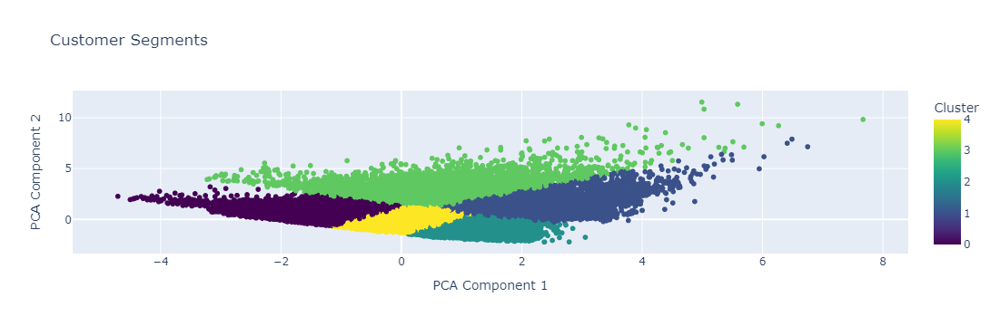

In [69]:
import plotly.express as px
import pandas as pd

# Assuming pca_data is a 2D numpy array with PCA results
# and clusters is a list/array of cluster labels

# Convert PCA data and clusters into a DataFrame
df_pca = pd.DataFrame(pca_data, columns=['PCA Component 1', 'PCA Component 2'])
df_pca['Cluster'] = clusters

# Create scatter plot using Plotly Express
fig = px.scatter(df_pca, x='PCA Component 1', y='PCA Component 2', color='Cluster', 
                 title='Customer Segments', 
                 labels={'PCA Component 1': 'PCA Component 1', 'PCA Component 2': 'PCA Component 2'},
                 color_continuous_scale=px.colors.sequential.Viridis)

# Show the plot
fig.show()


In [70]:
class_mapping = dict(zip(label_encoder.classes_, label_encoder.transform(label_encoder.classes_)))

# Print the mapping
print(class_mapping)

{'basic.4y': 0, 'basic.6y': 1, 'basic.9y': 2, 'high.school': 3, 'illiterate': 4, 'primary': 5, 'professional.course': 6, 'secondary': 7, 'tertiary': 8, 'university.degree': 9, 'unknown': 10}


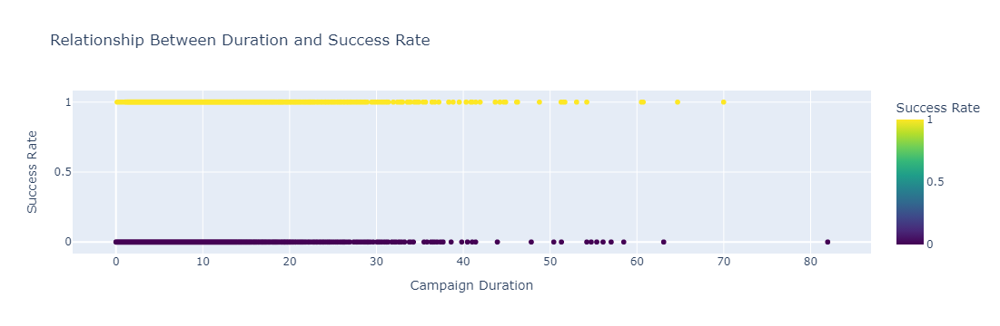

In [71]:
fig = px.scatter(data_frame=data, x='duration', y='y', 
                 title='Relationship Between Duration and Success Rate',
                 labels={'duration': 'Campaign Duration', 'y': 'Success Rate'},
                 color='y',  # Optional: color points based on success rate
                 color_continuous_scale=px.colors.sequential.Viridis)  # Optional: color scale

# Show the plot
fig.show()

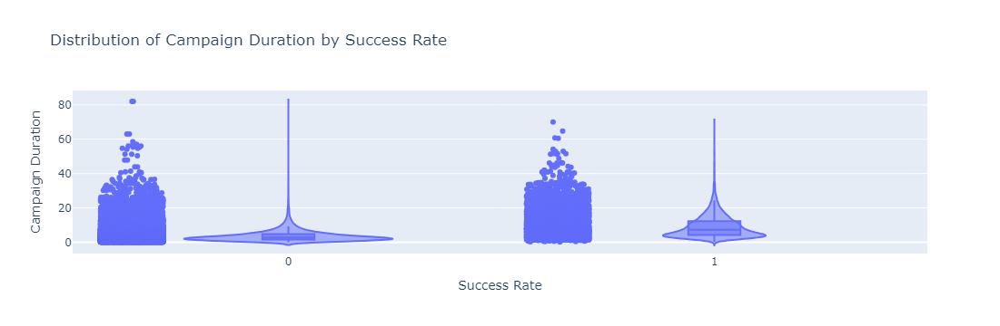

In [72]:
fig = px.violin(data_frame=data, y='duration', x='y', box=True, points='all',
                title='Distribution of Campaign Duration by Success Rate',
                labels={'duration': 'Campaign Duration', 'y': 'Success Rate'})
fig.update_xaxes(title_text='Success Rate')
fig.update_yaxes(title_text='Campaign Duration')
fig.show()

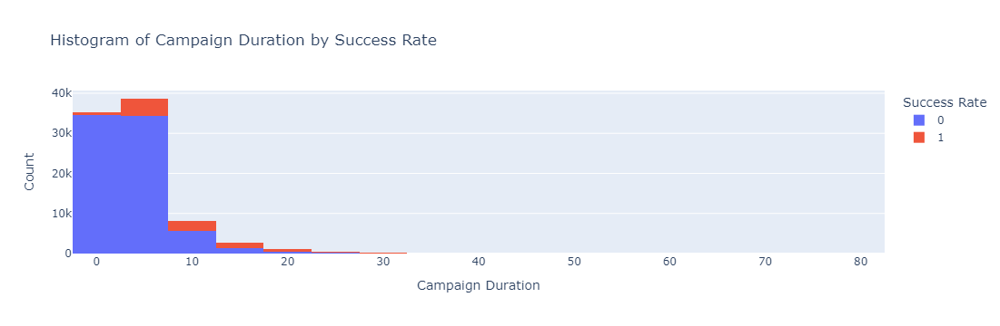

In [73]:
fig = px.histogram(data_frame=data, x='duration', color='y',
                   title='Histogram of Campaign Duration by Success Rate',
                   labels={'duration': 'Campaign Duration', 'y': 'Success Rate'},
                   nbins=30)
fig.update_xaxes(title_text='Campaign Duration')
fig.update_yaxes(title_text='Count')
fig.show()

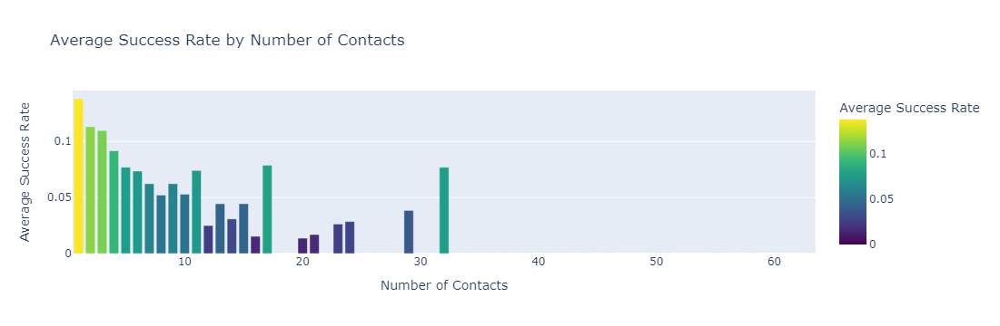

In [74]:
contact_performance = data.groupby('campaign')['y'].mean().reset_index()

# Create the bar chart
fig = px.bar(contact_performance, x='campaign', y='y', 
             title='Average Success Rate by Number of Contacts',
             labels={'campaign': 'Number of Contacts', 'y': 'Average Success Rate'},
             color='y',  # Optional: color bars based on success rate
             color_continuous_scale=px.colors.sequential.Viridis)
fig.show()

In [75]:
data.groupby('poutcome').count()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,balance,day,year,date
poutcome,,,,,,,,,,,,,,,,,,,,,,,,
failure,9153,9153,9153,9153,9153,9153,9153,9153,9153,9153,9153,9153,9153,9153,4252,4252,4252,4252,4252,9153,4901,4901,4901,4901
nonexistent,74362,74362,74362,74362,74362,74362,74362,74362,74362,74362,74362,74362,74362,74362,35563,35563,35563,35563,35563,74362,38799,38799,38799,38799
success,2884,2884,2884,2884,2884,2884,2884,2884,2884,2884,2884,2884,2884,2884,1373,1373,1373,1373,1373,2884,1511,1511,1511,1511


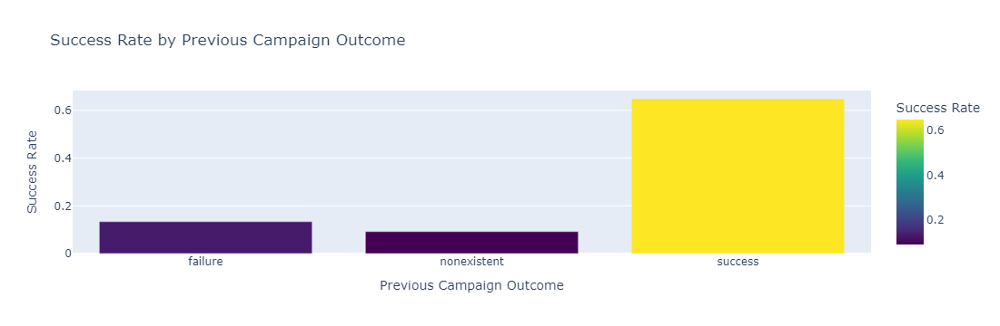

In [76]:
poutcome_performance = data.groupby('poutcome')['y'].mean().reset_index()
poutcome_performance.columns = ['poutcome', 'success_rate']

# Create the bar chart
fig = px.bar(poutcome_performance, x='poutcome', y='success_rate', 
             title='Success Rate by Previous Campaign Outcome',
             labels={'poutcome': 'Previous Campaign Outcome', 'success_rate': 'Success Rate'},
             color='success_rate',
             color_continuous_scale=px.colors.sequential.Viridis)  # Optional: color scale

# Show the plot
fig.show()

We see that if person took part in previous compaign the Succes Rate is much higher

In [78]:
filtered_data = data[['emp.var.rate', 'cons.price.idx', 'cons.conf.idx', 'euribor3m', 'nr.employed', 'y']].dropna()

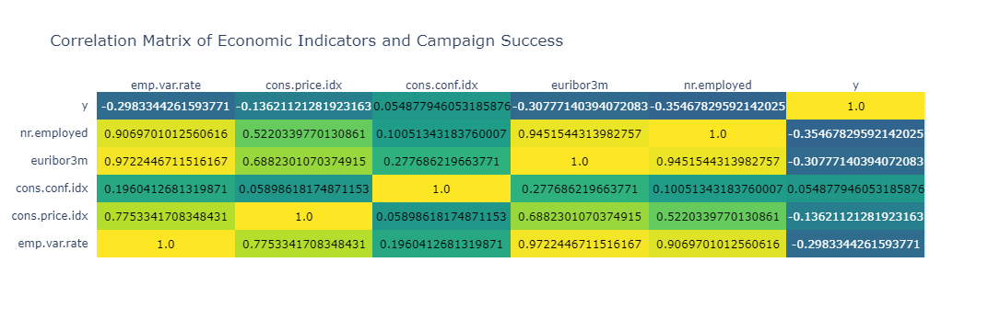

In [79]:
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff

# Create a correlation matrix
corr_matrix = filtered_data.corr()

# Heatmap of the correlation matrix
fig = ff.create_annotated_heatmap(
    z=corr_matrix.values,
    x=list(corr_matrix.columns),
    y=list(corr_matrix.index),
    colorscale='Viridis',
    zmin=-1,
    zmax=1
)
fig.update_layout(title='Correlation Matrix of Economic Indicators and Campaign Success')
fig.show()

There is no real correlation between our target action and Economic Indicators

In [81]:
data.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,balance,day,year,date
0,56,housemaid,married,basic.4y,0,0,0,telephone,may,Monday,4.35,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,0,NaN,NaN,NaN,NaT
1,57,services,married,high.school,unknown,0,0,telephone,may,Monday,2.48,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,0,NaN,NaN,NaN,NaT
2,37,services,married,high.school,0,1,0,telephone,may,Monday,3.77,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,0,NaN,NaN,NaN,NaT
3,40,admin.,married,basic.6y,0,0,0,telephone,may,Monday,2.52,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,0,NaN,NaN,NaN,NaT
4,56,services,married,high.school,0,0,1,telephone,may,Monday,5.12,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,0,NaN,NaN,NaN,NaT


In [155]:
data.head()

,age,job,marital,education,default,housing,loan,contact,month,day_of_week,duration,campaign,pdays,previous,poutcome,emp.var.rate,cons.price.idx,cons.conf.idx,euribor3m,nr.employed,y,balance,day,year,date
0,56,housemaid,married,basic.4y,0,0,0,telephone,may,Monday,4.35,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,0,NaN,NaN,NaN,NaT
1,57,services,married,high.school,unknown,0,0,telephone,may,Monday,2.48,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,0,NaN,NaN,NaN,NaT
2,37,services,married,high.school,0,1,0,telephone,may,Monday,3.77,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,0,NaN,NaN,NaN,NaT
3,40,admin.,married,basic.6y,0,0,0,telephone,may,Monday,2.52,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,0,NaN,NaN,NaN,NaT
4,56,services,married,high.school,0,0,1,telephone,may,Monday,5.12,1,999,0,nonexistent,1.1,93.994,-36.4,4.857,5191.0,0,NaN,NaN,NaN,NaT


In [159]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 86399 entries, 0 to 86398
Data columns (total 25 columns):
 #   Column          Non-Null Count  Dtype         
---  ------          --------------  -----         
 0   age             86399 non-null  int64         
 1   job             86399 non-null  object        
 2   marital         86399 non-null  object        
 3   education       86399 non-null  object        
 4   default         86399 non-null  object        
 5   housing         86399 non-null  object        
 6   loan            86399 non-null  object        
 7   contact         86399 non-null  object        
 8   month           86399 non-null  object        
 9   day_of_week     86399 non-null  object        
 10  duration        86399 non-null  float64       
 11  campaign        86399 non-null  int64         
 12  pdays           86399 non-null  int64         
 13  previous        86399 non-null  int64         
 14  poutcome        86399 non-null  object        
 15  em

AttributeError: 'Series' object has no attribute 'barplot'

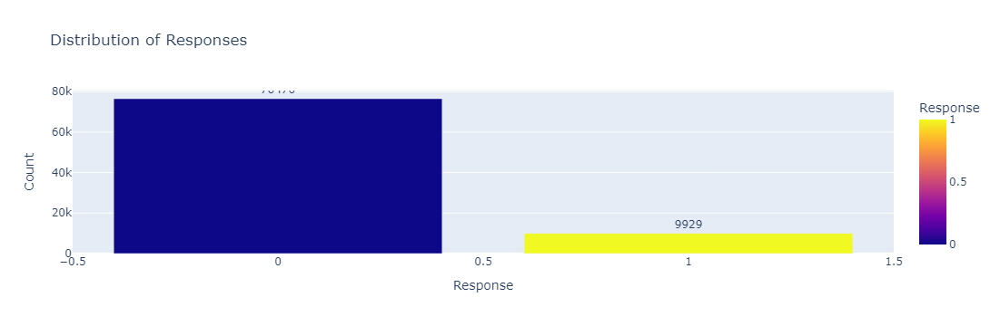

In [169]:
import plotly.express as px

# Count the occurrences of each category in the column
counts = data['y'].value_counts().reset_index()
counts.columns = ['Response', 'Count']

# Create the bar chart
fig = px.bar(counts,
             x='Response',
             y='Count',
             title='Distribution of Responses',
             labels={'Response': 'Response', 'Count': 'Count'},
             color='Response')

# Add text labels to the bars
fig.update_traces(text=counts['Count'], textposition='outside')

# Show the plot
fig.show()
